In [8]:
class LinearRegression:
    '''
    A class which implements linear regression model with gradient descent.
    '''
    def __init__(self, learning_rate=0.5, n_iterations=1000):
        self.learning_rate = learning_rate
        self.n_iterations = n_iterations
        self.weights, self.bias = np.ones(10), 1
        self.loss = []
        
    @staticmethod
    def _mean_squared_error(y, y_hat):
        '''
        Private method, used to evaluate loss at each iteration.
        
        :param: y - array, true values
        :param: y_hat - array, predicted values
        :return: float
        '''
        error = 0
        for i in range(len(y)):
            error += (y[i] - y_hat[i]) ** 2
        return error / len(y)
    
    def fit(self, X, y):
        '''
        Used to calculate the coefficient of the linear regression model.
        
        :param X: array, features
        :param y: array, true values
        :return: None
        '''
        # 1. Initialize weights and bias to zeros
        self.weights = np.ones(X.shape[1])
        self.bias = 1
        
        # 2. Perform gradient descent
        for i in range(self.n_iterations):
            # Line equation
            y_hat = np.dot(X, self.weights) + self.bias
            print("y_hat",y_hat)
            loss = self._mean_squared_error(y, y_hat)
            self.loss.append(loss)
            print("loss is ", self.loss)
            # Calculate derivatives
            partial_w = (1 / X.shape[0]) * (2 * np.dot(X.T, (y_hat - y)))
            print("partial_w:",partial_w)
            partial_d = (1 / X.shape[0]) * (2 * np.sum(y_hat - y))
            print("partial_d:",partial_d)
            # Update the coefficients
            self.weights -= self.learning_rate * partial_w
            self.bias -= self.learning_rate * partial_d
        
        print("Weights and bias are " ,self.weights, self.bias)
    def predict(self, X):
        '''
        Makes predictions using the line equation.
        
        :param X: array, features
        :return: array, predictions
        '''
        return np.dot(X, self.weights) + self.bias

In [9]:
from sklearn.datasets import load_diabetes

data = load_diabetes()
X = data.data
y = data.target

In [10]:
from sklearn.model_selection import train_test_split
import numpy as np
import matplotlib.pyplot as plt

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

model = LinearRegression()
model.fit(X_train, y_train)
preds = model.predict(X_test)

y_hat [1.29436843 0.99983712 1.0708801  0.55913092 0.59611577 0.55430684
 1.0315673  1.34713952 0.91054627 0.73178505 0.83076498 1.17066369
 0.61041759 1.21488782 0.64088301 1.18578414 0.48160214 0.9864585
 1.08383246 1.28396872 0.82617677 1.02223536 1.15738353 1.23157839
 1.29888497 1.1795406  0.86682653 0.74612614 0.88424213 0.58572032
 0.99564147 0.86230691 0.76769236 0.82769043 1.16089986 0.97511968
 1.12418565 1.02716978 0.70713781 1.07577766 0.4609994  1.3862727
 0.77659186 1.06813435 1.11103456 1.31141692 1.14444174 1.25159128
 1.12965224 0.81369326 1.23335716 0.59400905 1.48889568 1.48095659
 0.65329025 1.24676931 1.3099032  0.99467349 1.24506971 1.23487474
 1.19677411 1.21852418 0.94493027 1.03462285 1.33483793 0.89539175
 1.04983026 0.65952825 1.03015245 1.29547132 1.2455092  0.90238309
 0.65883555 0.75066614 0.90953444 1.06571324 1.03678892 1.00176337
 0.59615082 0.84400521 0.97042814 1.06394342 0.64468614 0.86459795
 1.05016005 1.02819188 1.45908053 1.11434332 1.22749262 1.

y_hat [172.29214276 159.09663916 168.78865371 122.09548342 117.3200037
 113.6169386  162.41057127 189.8256571  159.02444792 127.55661249
 129.01261767 167.62011151 135.68223448 189.40772477 128.36802909
 159.44407762 119.0449023  147.12463596 152.64316728 164.72904247
 150.48598277 152.19665187 162.35887038 172.89401867 178.50813585
 170.94487099 153.35663268 144.39154205 146.81935789 125.21823065
 154.40468049 147.46532943 135.61630778 128.02868714 158.52890247
 149.39522669 157.49586943 161.85593766 135.32453754 167.61991845
 120.12587011 161.79578596 128.02457678 174.04473055 174.96365135
 178.54322302 165.32380472 189.09081586 164.5357296  126.72971241
 171.74375552 125.8454049  179.51504286 192.6356099  129.58623429
 186.69854467 180.24238099 153.55259327 179.71667884 164.59335028
 166.84967965 168.05613059 162.23222443 143.15142354 181.87995932
 140.63270003 162.76616936 138.80490122 139.53186027 163.92325076
 159.59229775 150.10270093 123.6835498  126.06018203 145.9359042
 144.3

y_hat [178.98328032 160.53310067 176.43857395 110.20538879 102.76595248
  97.32541236 166.71905861 205.2332679  161.86259235 117.29003721
 118.10583031 173.40769743 128.38008791 205.74891838 118.37185377
 160.9737077  106.41083671 143.91510776 151.36406595 168.62197352
 150.76398324 150.14458915 166.8946333  180.62562795 188.45357571
 177.95709666 153.23280091 141.23747315 144.10787744 115.06744815
 154.63829129 146.11927958 127.56357288 116.96315264 160.17658236
 147.33873188 160.08207661 164.65637156 128.28170871 173.31332905
 107.81558937 162.87776059 117.79290724 183.4890132  184.55479199
 189.39945141 169.19988134 205.45032504 168.26206174 115.18576812
 179.85915973 115.00167683 187.78567404 207.33184952 120.07655904
 199.65182502 190.06952568 153.48978739 189.78503328 166.93841028
 170.95250042 173.00845496 168.11783695 138.42746889 192.18761479
 134.36160674 166.38924939 134.08464418 132.6604316  165.64837121
 161.34194484 149.1921111  111.60043856 114.44528688 143.26483135
 139

partial_w: [-0.19925706  0.62789064 -1.87301024 -1.25820822  0.21174299  0.41994219
  0.87354674 -0.58641621 -1.39200288 -0.63074056]
partial_d: 0.009385650600383108
y_hat [183.99684377 161.02251517 184.5163253  100.83747561  90.40878017
  83.27066877 171.18023997 219.25266253 164.93253882 108.80219302
 107.88258911 178.55549966 121.99638742 221.61792477 109.96386301
 161.58734624  96.84233843 140.65336679 149.46571123 171.5331219
 152.49058831 146.99470042 171.85698689 187.27843251 196.96693442
 184.03108557 153.12611477 139.07589252 141.81295108 107.62671248
 154.85148326 146.09457795 119.95122162 106.79062829 161.36008966
 145.25686753 163.33733802 166.60400526 122.54020094 178.25033468
  98.36645539 161.8271512  109.15394649 192.72476121 193.72727866
 199.56181562 171.73929337 221.50484876 170.81823244 104.7040352
 187.70380265 106.01981054 192.92872051 218.99142175 112.10874833
 210.39580362 197.71225217 153.45420756 198.05172051 167.03655316
 173.30400443 176.48097232 175.5274795

partial_w: [-0.07181614  0.65148273 -1.49408021 -0.96227454  0.33829371  0.51573063
  0.62285148 -0.3115008  -1.0414475  -0.34994488]
partial_d: 0.007012945313671694
y_hat [186.52631316 160.64243294 191.04163247  95.66472066  82.66976495
  74.29806367 174.70742044 228.87717367 167.46443965 103.73095179
 100.59284637 181.98065607 117.8070895  233.39893664 104.74495817
 161.33920299  91.92362596 138.11287669 147.50273976 173.02034635
 154.93417904 143.70861056 175.99682646 191.52581349 202.3683346
 187.93119675 153.08403773 138.2024457  140.35442977 104.04253285
 155.05056924 147.10892923 114.50957263  99.65457331 161.90538793
 143.60922322 166.29950948 167.45851609 119.12171665 181.42563412
  93.33997861 159.36945928 103.76140044 199.59425362 200.40172345
 206.7867768  172.62182235 233.57002884 171.82072766  97.52730347
 193.52329772 100.57100011 194.45778695 225.53002065 107.21764906
 216.8938028  201.89605392 153.45362792 203.00930505 165.37615407
 173.69279855 177.97884729 182.409895

 127.75231333 124.49545351 138.56887299]
loss is  [29383.86814015168, 6013.6305824992805, 5974.796592488006, 5936.574736876227, 5898.9544701676605, 5861.925437968722, 5825.477469262129, 5789.600573130697, 5754.284935539832, 5719.520916177626, 5685.299045351595, 5651.6100209410115, 5618.4447054037755, 5585.794122836993, 5553.64945609012, 5522.002043929867, 5490.843378255888, 5460.165101366297, 5429.95900327226, 5400.217019060554, 5370.931226303474, 5342.09384251508, 5313.697222653019, 5285.7338566650815, 5258.196367079712, 5231.077506639665, 5204.370155978015, 5178.067321335844, 5152.1621323207255, 5126.647839705444, 5101.517813266034, 5076.765539658615, 5052.384620334169, 5028.368769490756, 5004.711812062312, 4981.407681743501, 4958.450419049876, 4935.834169412887, 4913.553181308891, 4891.601804421703, 4869.974487838005, 4848.665778275175, 4827.670318340698, 4806.982844822819, 4786.598187011802, 4766.511265051202, 4746.7170883186855, 4727.210753835806, 4707.987444706266, 4689.042428582

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



partial_w: [ 0.0246771   0.18020705 -0.21098944 -0.08954495  0.10704379  0.09616025
  0.02928647  0.00210257 -0.14235121  0.1276918 ]
partial_d: 0.0005013806526118684
y_hat [184.03448321 149.34143205 226.15466754  96.78212943  66.18101346
  55.94573201 191.70943662 259.60923055 181.24241749  99.0610025
  72.48023902 191.26166097 105.28837835 284.57893551  92.72881851
 152.07804658  97.23907267 125.99015248 130.64736394 173.07682686
 178.45616193 117.2078396  199.55136607 201.49361463 214.55184727
 196.55648887 155.17665501 143.39036912 134.7982867  110.65905096
 160.627607   163.61009594  96.67525308  69.95509889 160.77590262
 132.79256471 181.55248643 166.4532196  111.48232299 189.04082065
  92.35790701 130.06281917  90.04665077 226.89078957 226.68435758
 232.94478038 163.16656415 288.59255581 162.30878048  75.32240767
 220.69247402  89.34949859 177.00588798 227.54566249  98.0751263
 226.99207713 205.56440455 153.99478048 213.20430655 139.47059304
 155.84408736 171.59355403 230.042237

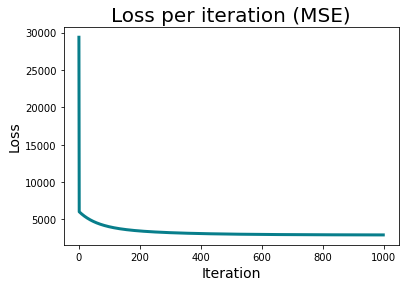

In [11]:
xs = np.arange(len(model.loss))
ys = model.loss

plt.plot(xs, ys, lw=3, c='#087E8B')
plt.title('Loss per iteration (MSE)', size=20)
plt.xlabel('Iteration', size=14)
plt.ylabel('Loss', size=14)
plt.show()

y_hat [1.29436843 0.99983712 1.0708801  0.55913092 0.59611577 0.55430684
 1.0315673  1.34713952 0.91054627 0.73178505 0.83076498 1.17066369
 0.61041759 1.21488782 0.64088301 1.18578414 0.48160214 0.9864585
 1.08383246 1.28396872 0.82617677 1.02223536 1.15738353 1.23157839
 1.29888497 1.1795406  0.86682653 0.74612614 0.88424213 0.58572032
 0.99564147 0.86230691 0.76769236 0.82769043 1.16089986 0.97511968
 1.12418565 1.02716978 0.70713781 1.07577766 0.4609994  1.3862727
 0.77659186 1.06813435 1.11103456 1.31141692 1.14444174 1.25159128
 1.12965224 0.81369326 1.23335716 0.59400905 1.48889568 1.48095659
 0.65329025 1.24676931 1.3099032  0.99467349 1.24506971 1.23487474
 1.19677411 1.21852418 0.94493027 1.03462285 1.33483793 0.89539175
 1.04983026 0.65952825 1.03015245 1.29547132 1.2455092  0.90238309
 0.65883555 0.75066614 0.90953444 1.06571324 1.03678892 1.00176337
 0.59615082 0.84400521 0.97042814 1.06394342 0.64468614 0.86459795
 1.05016005 1.02819188 1.45908053 1.11434332 1.22749262 1.

loss is  [29383.86814015168, 6013.6305824992805, 5974.796592488006, 5936.574736876227, 5898.9544701676605, 5861.925437968722, 5825.477469262129, 5789.600573130697, 5754.284935539832, 5719.520916177626, 5685.299045351595, 5651.6100209410115, 5618.4447054037755, 5585.794122836993, 5553.64945609012, 5522.002043929867, 5490.843378255888, 5460.165101366297, 5429.95900327226, 5400.217019060554, 5370.931226303474, 5342.09384251508, 5313.697222653019, 5285.7338566650815, 5258.196367079712, 5231.077506639665, 5204.370155978015, 5178.067321335844, 5152.1621323207255, 5126.647839705444, 5101.517813266034, 5076.765539658615, 5052.384620334169, 5028.368769490756, 5004.711812062312, 4981.407681743501, 4958.450419049876, 4935.834169412887, 4913.553181308891, 4891.601804421703, 4869.974487838005, 4848.665778275175, 4827.670318340698, 4806.982844822819, 4786.598187011802, 4766.511265051202, 4746.7170883186855, 4727.210753835806, 4707.987444706266, 4689.042428582149, 4670.371056157557, 4651.968759689224

partial_w: [-0.41679105  0.54052193 -2.41446105 -1.69001173 -0.05209821  0.19145725
  1.25653798 -1.05071953 -1.92661003 -1.0733709 ]
partial_d: 0.012900556210341954
y_hat [179.10500803 160.5534518  176.60106963 109.98439706 102.48669765
  97.01047837 166.80974093 205.53830105 161.92361275 117.095199
 117.88697755 173.52112871 128.2382391  206.08228715 118.18094518
 160.99624705 106.17992451 143.84820101 151.33154033 168.69263993
 150.78419031 150.09127548 166.99268528 180.77485611 188.64506386
 178.09289624 153.2303084  141.18207506 144.05603077 114.88443476
 154.64272367 146.1045784  127.40119711 116.7432884  160.20604469
 147.29606523 160.14244158 164.70570636 128.14910943 173.42364313
 107.58948987 162.87887196 117.59716781 183.6824726  184.74913236
 189.61719028 169.26683336 205.78569259 168.32766047 114.95744833
 180.02426182 114.79597345 187.92551836 207.60572493 119.89514722
 199.89782056 190.25094186 153.48873729 189.97525894 166.96448794
 171.02011551 173.09620071 168.2546953

partial_w: [-0.19925706  0.62789064 -1.87301024 -1.25820822  0.21174299  0.41994219
  0.87354674 -0.58641621 -1.39200288 -0.63074056]
partial_d: 0.009385650600383108
y_hat [183.99684377 161.02251517 184.5163253  100.83747561  90.40878017
  83.27066877 171.18023997 219.25266253 164.93253882 108.80219302
 107.88258911 178.55549966 121.99638742 221.61792477 109.96386301
 161.58734624  96.84233843 140.65336679 149.46571123 171.5331219
 152.49058831 146.99470042 171.85698689 187.27843251 196.96693442
 184.03108557 153.12611477 139.07589252 141.81295108 107.62671248
 154.85148326 146.09457795 119.95122162 106.79062829 161.36008966
 145.25686753 163.33733802 166.60400526 122.54020094 178.25033468
  98.36645539 161.8271512  109.15394649 192.72476121 193.72727866
 199.56181562 171.73929337 221.50484876 170.81823244 104.7040352
 187.70380265 106.01981054 192.92872051 218.99142175 112.10874833
 210.39580362 197.71225217 153.45420756 198.05172051 167.03655316
 173.30400443 176.48097232 175.5274795

partial_w: [-0.0735943   0.65144117 -1.50000137 -0.96684112  0.33680351  0.51477319
  0.62661753 -0.31537207 -1.0467254  -0.35407797]
partial_d: 0.007049243002663283
y_hat [186.49439963 160.65450331 190.93124167  95.73486437  82.78455384
  74.43248796 174.64837686 228.72674583 167.42125216 103.80368681
 100.709171   181.92808505 117.87113045 233.20713826 104.8221033
 161.34873253  91.98661467 138.15517226 147.53917668 173.00121708
 154.88542064 143.76959405 175.92583773 191.4620727  202.28754512
 187.87255689 153.08426073 138.21093319 140.37644583 104.08581936
 155.04666123 147.08437241 114.59624645  99.7678162  161.89908935
 143.63706601 166.24739171 167.44901044 119.17105892 181.37783536
  93.40652009 159.42244379 103.84140416 199.48257057 200.29424843
 206.67173633 172.61537783 233.37238755 171.8116474   97.63930497
 193.42842204 100.65039262 194.45047692 225.4401616  107.28927791
 216.7995404  201.83927936 153.45340277 202.93753878 165.41654218
 173.6973237  177.96289773 182.286969

 127.94062441 124.78781646 138.6577185 ]
loss is  [29383.86814015168, 6013.6305824992805, 5974.796592488006, 5936.574736876227, 5898.9544701676605, 5861.925437968722, 5825.477469262129, 5789.600573130697, 5754.284935539832, 5719.520916177626, 5685.299045351595, 5651.6100209410115, 5618.4447054037755, 5585.794122836993, 5553.64945609012, 5522.002043929867, 5490.843378255888, 5460.165101366297, 5429.95900327226, 5400.217019060554, 5370.931226303474, 5342.09384251508, 5313.697222653019, 5285.7338566650815, 5258.196367079712, 5231.077506639665, 5204.370155978015, 5178.067321335844, 5152.1621323207255, 5126.647839705444, 5101.517813266034, 5076.765539658615, 5052.384620334169, 5028.368769490756, 5004.711812062312, 4981.407681743501, 4958.450419049876, 4935.834169412887, 4913.553181308891, 4891.601804421703, 4869.974487838005, 4848.665778275175, 4827.670318340698, 4806.982844822819, 4786.598187011802, 4766.511265051202, 4746.7170883186855, 4727.210753835806, 4707.987444706266, 4689.042428582

  0.37535491 -0.08488825 -0.69237176 -0.0884322 ]
partial_d: 0.004555588816861624
y_hat [187.95652725 159.12884094 199.68519501  91.91805417  75.28160126
  65.5342922  179.2556483  239.40105841 170.87751515  99.36456988
  92.18298903 185.54935087 113.45231629 247.66621022  99.78429605
 160.06793348  88.9984064  134.87095063 144.30816637 173.94794839
 159.46835622 138.39055574 181.65020973 195.710253   207.64630078
 191.77954517 153.14144341 138.1632627  138.86519952 102.3566662
 155.46505946 149.7582474  108.30340488  91.48278248 162.11346937
 141.3991586  170.51879555 167.74611393 116.05698925 184.57175498
  89.92281854 154.11576986  98.57988541 207.84695661 208.25535377
 215.06352093 172.27213716 248.40835953 171.71239889  89.71215076
 200.62048041  95.59068409 193.24114909 230.50010638 102.71082337
 222.72232629 205.00100635 153.49909648 207.46988991 161.02806568
 172.1997575  178.29874092 192.68609359 127.62719707 206.47571368
 116.84858258 173.10346641 131.62443686 113.68182216 15

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



partial_w: [ 0.02244089  0.16896764 -0.19765268 -0.08287277  0.10079409  0.08706707
  0.02601665  0.00059019 -0.13512885  0.12519412]
partial_d: 0.00045799884556154547
y_hat [183.93325757 149.1146343  226.65092242  97.05346209  66.10742596
  55.97562223 191.89874976 259.85384226 181.41778865  99.20955
  72.15620957 191.31999506 105.17774683 285.20411597  92.63521891
 151.91640118  97.52929754 125.85923911 130.33708271 173.05748237
 178.81949456 116.77104888 199.87629527 201.54136762 214.58329721
 196.57576218 155.26074461 143.52644555 134.67833379 110.87830515
 160.85136978 163.89625791  96.58998601  69.50220303 160.75774443
 132.57260465 181.65313767 166.46324075 111.3800602  189.09801341
  92.41793675 129.60046846  89.87226301 227.14306408 226.97260064
 233.17348517 162.9069245  289.30780133 161.99297678  75.18151541
 221.09158668  89.25849133 176.69399512 227.32582344  98.04379476
 226.93983758 205.58259108 154.00635674 213.30330762 139.06522789
 155.37725088 171.42037005 230.796788

y_hat [157.64686067 154.88694626 156.41131016 147.20020935 146.44420461
 145.73789929 155.29502183 160.7747119  154.570425   148.46153202
 149.04182943 156.50115341 149.99931888 160.41076188 148.57354011
 155.10684912 146.47552188 152.55412369 153.73793664 156.14401201
 152.72928836 153.71058762 155.33292816 157.5831012  158.7154235
 157.16334467 153.54654931 151.65535633 152.31294991 147.74480961
 153.86058286 152.24229468 150.20566988 148.82002623 154.82356876
 152.95203896 154.39815464 155.38531296 149.94748588 156.44192835
 146.69396418 155.9271328  148.63923778 157.48433656 157.72467599
 158.5935935  156.19267703 160.35141892 156.01822399 148.53545775
 157.22483045 148.02760281 159.37846821 161.71316462 148.81114992
 160.28919401 159.17955334 153.69751069 158.95784794 156.32471749
 156.60573872 156.78253487 154.91175041 151.80389546 159.54379874
 151.31827178 155.50438887 150.40976878 151.23396584 156.29677833
 155.15293343 152.88604693 147.72320612 148.3347609  152.10693815
 152.

y_hat [161.31881832 156.0208467  159.19241682 140.98027808 139.34899645
 137.95423102 156.9080061  167.70920662 155.55824503 143.34295245
 144.30817495 159.1731567  146.53367745 167.17882256 143.63260022
 156.26822184 139.61965262 151.31242631 153.58875665 158.30440367
 151.95661137 153.55129316 156.88144295 161.30242104 163.53181115
 160.50130029 153.50886425 149.81023718 150.96776889 142.07733067
 154.00546223 150.91122039 146.77909745 143.86017162 155.76108105
 152.12879254 154.98159578 157.0364399  146.3389308  159.14844052
 140.06225447 157.65956136 143.60397967 161.32851149 161.76685312
 163.31192872 158.52902069 167.03395669 158.17757376 143.32938381
 160.62744031 142.581923   164.5803337  169.37127047 144.11246062
 166.76594116 164.43045484 153.66268101 164.07083468 158.63227452
 159.26427593 159.64110318 156.33814341 149.76562767 165.12535027
 148.86547939 157.27540793 147.40912671 148.55008592 158.49601609
 156.30941218 152.12770946 141.87750849 142.98484265 150.53685691
 150

loss is  [29383.86814015168, 20976.768166466234, 15593.436200979295, 12145.311432289198, 9935.719688634885, 8518.79252746667, 7609.176072075158, 7024.245063385587, 6647.120106769242, 6402.998872346093, 6244.008167077073, 6139.509327397955, 6069.893713061027, 6022.611850429412, 5989.632101615976, 5965.814223887522, 5947.868454822706, 5933.689331382066, 5921.92933703673, 5911.726037802099, 5902.527450496679, 5893.9802791940765, 5885.858387042411, 5878.017018542421, 5870.363502005989, 5862.838499257875, 5855.404005526742, 5848.035669427719, 5840.717877784625, 5833.440609937361, 5826.197424512125, 5818.9841709627935, 5811.798164962737, 5804.637660658814, 5797.5015129159, 5790.388961154521, 5783.299491007514, 5776.23274578057, 5769.188469787, 5762.16647208186, 5755.166603251686, 5748.188740559564, 5741.232778437796, 5734.298622402824, 5727.386185160518, 5720.495384113224, 5713.626139763894, 5706.778374694486, 5699.952012911732, 5693.146979428105, 5686.363199993352, 5679.600600922279, 5672.8

loss is  [29383.86814015168, 20976.768166466234, 15593.436200979295, 12145.311432289198, 9935.719688634885, 8518.79252746667, 7609.176072075158, 7024.245063385587, 6647.120106769242, 6402.998872346093, 6244.008167077073, 6139.509327397955, 6069.893713061027, 6022.611850429412, 5989.632101615976, 5965.814223887522, 5947.868454822706, 5933.689331382066, 5921.92933703673, 5911.726037802099, 5902.527450496679, 5893.9802791940765, 5885.858387042411, 5878.017018542421, 5870.363502005989, 5862.838499257875, 5855.404005526742, 5848.035669427719, 5840.717877784625, 5833.440609937361, 5826.197424512125, 5818.9841709627935, 5811.798164962737, 5804.637660658814, 5797.5015129159, 5790.388961154521, 5783.299491007514, 5776.23274578057, 5769.188469787, 5762.16647208186, 5755.166603251686, 5748.188740559564, 5741.232778437796, 5734.298622402824, 5727.386185160518, 5720.495384113224, 5713.626139763894, 5706.778374694486, 5699.952012911732, 5693.146979428105, 5686.363199993352, 5679.600600922279, 5672.8

partial_w: [-0.80470401  0.33078104 -3.25612937 -2.37253004 -0.58294193 -0.29638966
  1.88589796 -1.87469701 -2.80594383 -1.8178578 ]
partial_d: 0.018529886279046396
y_hat [169.50553771 158.36938836 166.12875084 126.93884387 123.05362505
 119.97909009 160.89461339 183.96970686 158.05432325 131.64657224
 133.09317333 165.39524933 138.52201421 183.4168833  132.32881793
 158.68796261 124.28118992 148.26934523 152.96939222 163.10175912
 150.7131689  152.69211385 160.8198354  169.86792478 174.60422159
 168.21207068 153.40027187 145.74922225 147.89426666 129.48328433
 154.30667135 148.24670676 138.60749809 132.2223827  157.83103643
 150.13631114 156.72442018 160.65048534 138.16039958 165.40242876
 125.20658896 160.92473539 132.07086668 170.60398705 171.41972126
 174.48009618 163.63076443 183.12885478 162.93814914 131.12233792
 168.75590903 130.17362188 175.82771472 186.66378552 133.35627173
 181.53760723 176.20565028 153.58027366 175.67952044 163.2405076
 164.98648625 165.94116784 160.451752

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



partial_w: [-0.14315628  0.64156166 -1.71347309 -1.13296489  0.27065104  0.46649487
  0.76627045 -0.46578411 -1.24211027 -0.5096175 ]
partial_d: 0.008377860193413989
y_hat [185.10881622 160.93727718 187.06804069  98.61936262  87.20055315
  79.56691586 172.56636332 223.15551983 165.91857502 106.67257506
 104.95314029 179.95517475 120.28077466 226.30936255 107.79684982
 161.55047844  94.69092462 139.65223681 148.73405452 172.18326141
 153.36212156 145.77028198 173.46513922 189.03080232 199.19857558
 185.63865005 153.10468643 138.66347215 141.21204779 106.0292172
 154.92434392 146.40771774 117.76349857 103.91481669 161.60641166
 144.61153799 164.47186682 166.99465812 121.10682232 179.55854334
  96.19156819 160.99518954 106.91807656 195.46127432 196.39816269
 202.46779945 172.17981417 226.29595501 171.29832906 101.79191467
 190.02027199 103.74425689 193.73689551 221.78219298 110.0707761
 213.11350511 199.50717006 153.45143014 200.12766374 166.52657753
 173.58045503 177.17261746 178.1457655

y_hat [185.59224213 160.86725167 188.30519698  97.63239302  85.72753315
  77.85947774 173.23534826 224.98474856 166.39848879 105.70635913
 103.56854477 180.60651722 119.48412478 228.54565773 106.80347236
 161.50532522  93.75115553 139.17033032 148.3630942  172.46730635
 153.8228147  145.14920538 174.24968288 189.83897506 200.22641192
 186.38074251 153.09646664 138.49562532 140.93464742 105.34353637
 154.96175849 146.59741212 116.72975992 102.55931813 161.71082854
 144.29922913 165.03291389 167.15834563 120.4557845  180.16269763
  95.23208904 160.53322793 105.89175696 196.76541123 197.66559282
 203.84021139 172.350193   228.58572981 171.49130004 100.42784597
 191.12482681 102.70672104 194.03328326 223.02928687 109.13949229
 214.35106242 200.30526207 153.45122393 201.07179791 166.2160761
 173.65822078 177.45994799 179.44829411 132.21045014 202.5507855
 125.1538042  170.60045144 130.69614834 122.61172131 163.60474953
 162.39705366 148.9744664   97.29635136  99.84279446 140.92431419
 131.3

partial_w: [-1.73955079 -0.08525003 -4.83696706 -3.61226001 -1.32930766 -0.9370447
  3.03219238 -3.22606376 -4.37144025 -3.36087855]
partial_d: -234.89997083702244
y_hat [39.0375112  38.66573204 38.78256195 37.99641755 38.01133617 37.9456075
 38.71145655 39.18933142 38.57016632 38.19970394 38.32091932 38.88432388
 38.13750713 39.04900856 38.12136094 38.85456322 37.89894996 38.57990363
 38.71331332 38.97845681 38.43308622 38.65358661 38.83299271 38.97536253
 39.07522967 38.91335313 38.48921278 38.31808096 38.4734527  38.04244142
 38.62501157 38.4514464  38.28842355 38.31533451 38.8193382  38.58565762
 38.78050696 38.70388427 38.23401773 38.78911981 37.88929651 39.06973293
 38.25899918 38.81882933 38.86582601 39.08803608 38.84476678 39.08198981
 38.83034785 38.28568428 38.96607093 38.05921825 39.27274724 39.34498139
 38.13812089 39.07215589 39.09513675 38.62304138 39.02647832 38.93424353
 38.9139944  38.93668395 38.61277249 38.59862194 39.1329672  38.45344917
 38.73232285 38.19663467 38.

 113.88130286 113.67895623 114.00218293]
loss is  [29383.86814015168, 28459.16446238466, 27571.04842661745, 26718.071152415734, 25898.841135786053, 25112.021977037937, 24356.330198623953, 23630.53314939428, 22933.446991844026, 22263.934769066702, 21620.904548257346, 21003.307637733757, 20410.136874564985, 19840.42498001023, 19293.24298008358, 18767.698688665198, 18262.93525068186, 17778.129742978694, 17312.491830596806, 16865.262476263313, 16435.712700986114, 16023.142393729784, 15626.879168228992, 15246.27726507269, 14880.716497266409, 14529.60123755073, 14192.3594458226, 13868.441735071312, 13557.320474303786, 13258.488926994656, 12971.460423654044, 12695.767567162191, 12430.961469573225, 12176.611019142003, 11932.30217637685, 11697.637297969302, 11472.234487496318, 11255.726971835216, 11047.762502272832, 10848.002779331082, 10656.122900369763, 10471.810829064561, 10294.766885894063, 10124.703258803644, 9961.343533247471, 9804.422240840993, 9653.68442588709, 9508.885229067959, 9369.7

partial_w: [-1.41035645 -0.02704628 -4.41953684 -3.32002959 -1.39855369 -1.06022766
  2.78145009 -3.08351279 -4.05530778 -2.9137255 ]
partial_d: -28.135447362425417
y_hat [141.15185477 140.23528307 140.66704314 137.95721956 137.8046388
 137.58656066 140.36418088 141.9838722  140.08718215 138.3955181
 138.64117614 140.77520119 138.71562524 141.78767061 138.37481545
 140.43531225 137.71602452 139.63679584 140.01510145 140.75842647
 139.56407647 139.96642549 140.46232982 141.08858998 141.42227885
 140.94830256 139.77834221 139.22459974 139.49809959 138.1227621
 139.95761534 139.46517873 138.86334872 138.59529835 140.33698258
 139.74097862 140.22876464 140.36884026 138.78706113 140.68532645
 137.76653415 140.7816695  138.50557742 140.9527676  141.03977588
 141.41188002 140.66698263 141.79752598 140.6277471  138.49121087
 140.99774786 138.20267108 141.7153318  142.31573265 138.43590176
 141.77556878 141.53394372 139.92789848 141.43158796 140.76466733
 140.82840836 140.87635315 140.18961979 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



partial_w: [-1.19393079  0.09150404 -4.03269825 -3.00870976 -1.15088589 -0.83212531
  2.48755195 -2.70024748 -3.64817719 -2.53944512]
partial_d: 0.02378108205088824
y_hat [159.51844472 155.4700544  157.81037753 144.03690132 142.8426305
 141.78934478 156.10774102 164.28800342 155.06713157 145.86213273
 146.64802741 157.85654904 148.24187469 163.83046398 146.06458497
 155.70372934 142.98513507 151.92943889 153.67008774 157.24609244
 152.32437784 153.64312509 156.11041287 159.47186911 161.16155768
 158.85790619 153.52896152 150.71496976 151.63040791 144.85739831
 153.93598469 151.55741288 148.4745551  146.30880305 155.30262021
 152.53747573 154.6849615  156.2291708  148.11334    157.81605002
 143.31812209 156.82583855 146.08272857 159.42565972 159.76853489
 160.98175063 157.3865262  163.72637103 157.12049574 145.89945353
 158.94547879 145.26097384 162.03843526 165.60988788 146.42548764
 163.58124444 161.85388024 153.68082764 161.5583296  157.51488969
 157.96615668 158.24158985 155.6156718

partial_w: [-1.18205066  0.09906721 -4.00961909 -2.98974236 -1.13321384 -0.81533642
  2.46946454 -2.67505521 -3.62283498 -2.51765851]
partial_d: 0.023648908853205693
y_hat [159.82575848 155.56467158 158.04378689 143.51573023 142.24788369
 141.13680772 156.24301125 164.86926953 155.14996026 145.43308003
 146.25085608 158.08038147 147.95124149 164.3981189  145.650412
 155.80065469 142.41082825 151.8250394  153.65716375 157.42681023
 152.2599642  153.6291482  156.24037265 159.78340662 161.56501676
 159.13750722 153.52561412 150.56034873 151.51753464 144.3826951
 153.94792429 151.44607312 148.18695206 145.89277366 155.38094042
 152.46823078 154.73407546 156.36719897 147.81088493 158.04272959
 142.76257442 156.97017705 145.660639   159.74806403 160.10745684
 161.37729763 157.5819006  164.28690782 157.30110245 145.46277953
 159.2307461  144.80455552 162.4735242  166.25119765 146.03160313
 164.12373528 162.29346927 153.67774064 161.98650317 157.70744424
 158.18842157 158.48072443 155.73582634

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



partial_w: [-1.84271787 -0.1005117  -4.96380143 -3.69957756 -1.29683898 -0.88707359
  3.1061152  -3.2601695  -4.46330777 -3.49812732]
partial_d: -303.632449834237
y_hat [2.51593824 2.21917457 2.29154846 1.77185998 1.80821621 1.76570281
 2.25132246 2.57158733 2.12970981 1.94538387 2.04503151 2.39139446
 1.8257541  2.43910217 1.85486944 2.40521224 1.69375776 2.20370373
 2.3021263  2.50412562 2.04382898 2.24058458 2.37700975 2.45317169
 2.52141585 2.40085212 2.08488595 1.96275001 2.10136724 1.79902531
 2.2139073  2.07943891 1.98281146 2.04190262 2.38002157 2.19287667
 2.34329047 2.24680478 1.92248736 2.29649312 1.673485   2.6061022
 1.99065036 2.28995045 2.33296004 2.53397634 2.3647663  2.47569565
 2.3500095  2.0274244  2.45463381 1.80755618 2.71160831 2.70601652
 1.86739157 2.47070887 2.53266726 2.21292691 2.46772885 2.455159
 2.41760821 2.43937077 2.164331   2.25099964 2.55798336 2.1116149
 2.26964474 1.87515287 2.24616129 2.515645   2.46495972 2.12013256
 1.87201868 1.9643866  2.126542

y_hat [18.63179107 18.30394788 18.39479806 17.76464216 17.79218494 17.73995389
 18.34182047 18.72740193 18.2120111  17.95038065 18.05915333 18.4954775
 17.85475457 18.59166771 17.86509453 18.49119786 17.67853745 18.2593384
 18.37231087 18.6003542  18.10500758 18.31153126 18.46574832 18.56931771
 18.65063819 18.51303161 18.15200701 18.00973595 18.15531419 17.7997283
 18.28387082 18.13342067 18.00901447 18.05514383 18.46179296 18.25551492
 18.42452475 18.33582366 17.95153925 18.4004047  17.66276641 18.69783225
 18.00176772 18.40904094 18.45363466 18.66345548 18.46333608 18.62674649
 18.44888476 18.03416375 18.5663489  17.81165194 18.84360096 18.87048176
 17.87929045 18.61960158 18.66529749 18.28260492 18.59886007 18.55325417
 18.52312707 18.54516326 18.249937   18.29466278 18.69586384 18.15301605
 18.36107715 17.90817354 18.28459397 18.61223157 18.55122493 18.18266247
 17.87107762 17.97087928 18.17877691 18.33012867 18.33955426 18.28405099
 17.81351011 18.10103757 18.22434115 18.36789971

partial_w: [-1.74972341 -0.086762   -4.84948282 -3.62087996 -1.32613184 -0.93214452
  3.03949251 -3.2294519  -4.38051586 -3.3744186 ]
partial_d: -241.66783875239557
y_hat [33.52832871 33.16861387 33.2783156  32.53499695 32.55338852 32.49135666
 33.21219189 33.6647257  33.07404995 32.73345377 32.85127058 33.37978405
 32.66209758 33.52566267 32.65322199 33.35701611 32.44065146 33.09410478
 33.22190783 33.47685285 32.94523711 33.16189296 33.33438101 33.46609445
 33.56086647 33.40566119 32.99882871 32.83563741 32.98832182 32.57802771
 33.13355029 32.96635291 32.81390789 32.84613141 33.32338381 33.09724169
 33.28501357 33.2050318  32.75869716 33.28461163 32.42932792 33.5698257
 32.79060695 33.3085499  33.35488028 33.57369066 33.34224824 33.55921815
 33.32783622 32.81884129 33.45854136 32.59346964 33.75710805 33.81691053
 32.66927005 33.55010825 33.57931553 33.13178538 33.51127101 33.43183707
 33.40889996 33.43139958 33.11537067 33.11737036 33.61515759 32.97317878
 33.23260477 32.71965663 33

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



partial_w: [-1.50043402 -0.04628284 -4.53819833 -3.40474216 -1.3915777  -1.03915792
  2.85524488 -3.13427395 -4.1498304  -3.03929262]
partial_d: -80.3369523268133
y_hat [114.45931558 113.80853951 114.08748244 112.31467603 112.24557724
 112.09956181 113.89884967 114.96184969 113.68706043 112.63571041
 112.82536448 114.19375388 112.77426921 114.79263254 112.59124778
 114.00439202 112.14397974 113.46038566 113.72054487 114.22775796
 113.35418964 113.66685937 114.0074149  114.39729083 114.61631778
 114.29630586 113.48460311 113.12125186 113.3376792  112.42431298
 113.6434857  113.31141464 112.91777597 112.80229    113.93540498
 113.51962986 113.8685331  113.89283292 112.86120413 114.10022915
 112.16755061 114.28302077 112.72825687 114.2551566  114.32110595
 114.62066494 114.11558427 114.81331126 114.09229719 112.72945617
 114.34662072 112.47307748 114.85702023 115.20483895 112.6287924
 114.79430732 114.67922912 113.63020699 114.59420576 114.20731647
 114.23587027 114.26882647 113.75982425 

partial_w: [-1.48721623 -0.04378546 -4.52122352 -3.39277922 -1.39377856 -1.04349219
  2.84492658 -3.12798159 -4.13674948 -3.02118338]
partial_d: -72.24662928254729
y_hat [118.53650049 117.85841471 118.1530832  116.28392225 116.20635475
 116.05280742 117.95278845 119.07300766 117.73424303 116.61686052
 116.81255257 118.25963351 116.7743629  118.9009912  116.57509098
 118.05477044 116.10599909 117.48455022 117.75692815 118.28823571
 117.38192643 117.70378598 118.06022316 118.47438033 118.70515527
 118.36942056 117.52058582 117.13788098 117.36020937 116.39943665
 117.68161123 117.33332654 116.91797757 116.78731339 117.98268019
 117.54858682 117.9119776  117.94761098 116.85988882 118.16642464
 116.13247792 118.34015734 116.71162552 118.33310055 118.40112732
 118.70817517 118.17818788 118.9205298  118.15348168 116.7109766
 118.41959627 116.45139097 118.95092688 119.32497984 116.61494436
 118.90107705 118.77285494 117.66680982 118.68609766 118.27043233
 118.30292606 118.33726505 117.81000964

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[134.09589863 133.27640195 133.6523738  131.28462137 131.16275706
 130.97074348 133.39138973 134.80780456 133.13809557 131.67980607
 131.9055947  133.76002832 131.93419572 134.62139357 131.65093396
 133.475055   131.06920272 132.76936141 133.10468013 133.7614348
 132.68466113 133.05423892 133.49321837 134.03314309 134.32488819
 133.90733705 132.86757326 132.38378074 132.63651577 131.43000928
 133.03949602 132.60614711 132.07973068 131.86840171 133.38725875
 132.85748196 133.29496861 133.39164425 132.01165741 133.6687026
 131.11015707 133.79628543 131.78431552 133.89541787 133.97456322
 134.32024412 133.66241449 134.63514372 133.62944455 131.77514061
 133.95699148 131.4985327  134.5982184  135.10692709 131.70320061
 134.61399762 134.41831048 133.01611712 134.32237504 133.75773793
 133.8092729  133.85142282 133.22958413 132.63397078 134.52261132
 132.43704254 133.44199892 132.05328526 132.52399729 133.79751392
 133.53452207 132.78276228 131.48294888 131.69273027 132.6200466
 132.73932835

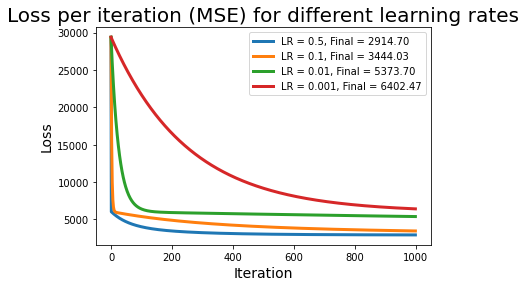

In [5]:
losses = {}
for lr in [0.5, 0.1, 0.01, 0.001]:
    model = LinearRegression(learning_rate=lr)
    model.fit(X_train, y_train)
    losses[f'LR={str(lr)}'] = model.loss
    
    
xs = np.arange(len(model.loss))

plt.plot(xs, losses['LR=0.5'], lw=3, label=f"LR = 0.5, Final = {losses['LR=0.5'][-1]:.2f}")
plt.plot(xs, losses['LR=0.1'], lw=3, label=f"LR = 0.1, Final = {losses['LR=0.1'][-1]:.2f}")
plt.plot(xs, losses['LR=0.01'], lw=3, label=f"LR = 0.01, Final = {losses['LR=0.01'][-1]:.2f}")
plt.plot(xs, losses['LR=0.001'], lw=3, label=f"LR = 0.001, Final = {losses['LR=0.001'][-1]:.2f}")
plt.title('Loss per iteration (MSE) for different learning rates', size=20)
plt.xlabel('Iteration', size=14)
plt.ylabel('Loss', size=14)
plt.legend()
plt.show()

In [6]:
model = LinearRegression(learning_rate=0.5)
model.fit(X_train, y_train)
preds = model.predict(X_test)

model._mean_squared_error(y_test, preds)

y_hat [1.29436843 0.99983712 1.0708801  0.55913092 0.59611577 0.55430684
 1.0315673  1.34713952 0.91054627 0.73178505 0.83076498 1.17066369
 0.61041759 1.21488782 0.64088301 1.18578414 0.48160214 0.9864585
 1.08383246 1.28396872 0.82617677 1.02223536 1.15738353 1.23157839
 1.29888497 1.1795406  0.86682653 0.74612614 0.88424213 0.58572032
 0.99564147 0.86230691 0.76769236 0.82769043 1.16089986 0.97511968
 1.12418565 1.02716978 0.70713781 1.07577766 0.4609994  1.3862727
 0.77659186 1.06813435 1.11103456 1.31141692 1.14444174 1.25159128
 1.12965224 0.81369326 1.23335716 0.59400905 1.48889568 1.48095659
 0.65329025 1.24676931 1.3099032  0.99467349 1.24506971 1.23487474
 1.19677411 1.21852418 0.94493027 1.03462285 1.33483793 0.89539175
 1.04983026 0.65952825 1.03015245 1.29547132 1.2455092  0.90238309
 0.65883555 0.75066614 0.90953444 1.06571324 1.03678892 1.00176337
 0.59615082 0.84400521 0.97042814 1.06394342 0.64468614 0.86459795
 1.05016005 1.02819188 1.45908053 1.11434332 1.22749262 1.

partial_w: [-0.81719951  0.32372166 -3.28253853 -2.3940165  -0.60039227 -0.31256852
  1.90586528 -1.9012202  -2.83385117 -1.84158162]
partial_d: 0.018707577200370328
y_hat [169.37534973 158.34062729 165.98294783 127.16969352 123.33495454
 120.29383332 160.81234632 183.67301962 158.00031953 131.84543782
 133.30276223 165.28362231 138.6628358  183.10359941 132.52204472
 158.65750421 124.52691837 148.33067404 152.99297637 163.02610635
 150.70967576 152.72990359 160.7336274  169.71858865 174.41209878
 168.07662565 153.40275903 145.81087203 147.94658849 129.68098474
 154.30235659 148.27416694 138.76229825 132.43510151 157.79891496
 150.17550459 156.67560692 160.59591036 138.29668696 165.29245791
 125.44572542 160.90133491 132.26861855 170.42286605 171.23557947
 174.27143643 163.55481937 182.81547671 162.86520271 131.34464865
 168.60036765 130.38340476 175.6655629  186.37862558 133.54023622
 181.28691619 176.01494457 153.58153259 175.48468444 163.19281563
 164.9055782  165.84448638 160.34116

partial_w: [-0.43788437  0.5304236  -2.46325964 -1.72927787 -0.079447    0.16693612
  1.29207988 -1.09560446 -1.97622688 -1.11496606]
partial_d: 0.01322237649193373
y_hat [178.60998922 160.46895752 175.94721557 110.8817117  103.61800963
  98.28569744 166.44462954 204.30519733 161.67826339 117.88515733
 118.77088378 173.06225957 128.81238443 204.73735395 118.95458139
 160.90301086 107.11864582 144.11774493 151.46103222 168.40524135
 150.70652064 150.30330771 166.59857973 180.17055394 187.86950324
 177.54308994 153.24039365 141.40795276 144.26610006 115.62916853
 154.62479301 146.16727844 128.05681985 117.63182878 160.08608103
 147.46798238 159.900886   164.50462381 128.68697568 172.97703372
 108.50828902 162.86883021 118.39028772 182.90216517 183.96472222
 188.73774938 168.99349092 204.43313615 168.06021205 115.88049656
 179.35807686 115.62995717 187.35368989 206.49390896 120.63037825
 198.90053304 189.51400834 153.49303969 189.2038157  166.85351542
 170.74302549 172.73866928 167.707031

  0.91441961 -0.6338952  -1.44907287 -0.67736288]
partial_d: 0.009765843515912663
y_hat [183.52243075 161.02050357 183.57726665 101.75675538  91.68573857
  84.73623382 170.66674013 217.7431431  164.57187358 109.66285801
 109.00228796 178.00878133 122.66908963 219.84680851 110.82863
 161.56900553  97.75474669 141.02584216 149.71633325 171.25702901
 152.21470019 147.41338104 171.27082202 186.58516088 196.08236556
 183.39613392 153.1361392  139.26514728 142.05079848 108.31862539
 154.82630994 146.02367974 120.78712048 107.89495839 161.2518438
 145.49551385 162.93354762 166.42969642 123.11964581 177.73389394
  99.27837538 162.06448714 110.04460405 191.69191724 192.71258408
 198.44998622 171.52689442 219.70291718 170.59561365 105.83129726
 186.82931203 106.93450027 192.5190592  217.84070126 112.92508615
 209.30207355 196.96671468 153.45648744 197.2142907  167.14985215
 173.13708532 176.17033804 174.60248155 134.51039154 199.26664473
 128.74613775 169.13588381 131.45696628 126.52101677 165.1

partial_w: [-0.0984658   0.64973131 -1.58034661 -1.02901215  0.31490096  0.49991777
  0.67825013 -0.36937422 -1.11903485 -0.41105597]
partial_d: 0.0075445249338452255
y_hat [186.03493233 160.79686135 189.46263558  96.72408024  84.36355675
  76.27702137 173.86075531 226.68542048 166.84780975 104.81361802
 102.27926522 181.21128247 118.74491243 230.63132197 105.88403065
 161.45839312  92.88964147 138.72006671 148.0133494  172.72758397
 154.26044315 144.56348443 174.984501   190.58797801 201.1787255
 187.06869049 153.08903336 138.3440886  140.67763503 104.71733416
 154.99688571 146.7814031  115.76704999 101.29801137 161.80592525
 144.00728533 165.55995265 167.30693124 119.85441112 180.72280866
  94.35088539 160.09087897 104.94158495 197.98182479 198.84674078
 205.11800833 172.50224347 230.7222646  171.66517794  99.1597806
 192.15493075 101.74744389 194.29399617 224.1778922  108.27795056
 215.49514184 201.03935612 153.4512054  201.94422889 165.91459821
 173.72149307 177.72052896 180.672534

partial_w: [-0.02005246  0.64613675 -1.30742165 -0.81954827  0.37567931  0.53526867
  0.50721418 -0.19790879 -0.87903814 -0.22488077]
partial_d: 0.005884876293255281
y_hat [187.38056226 160.13782762 194.69033262  93.67090847  79.17483576
  70.18146961 176.64591614 233.61649881 168.89807545 101.57283516
  96.87828753 183.6169229  115.8149205  239.59851251 102.39881221
 160.92575922  90.21678747 136.72774912 146.23608209 173.54402479
 156.68112379 141.59200058 178.36095455 193.48197716 204.84263273
 189.7315495  153.08875963 138.03872071 139.67272011 102.93155133
 155.19600294 148.05695467 111.74990175  96.04496713 162.05987067
 142.68573091 168.05242546 167.68482783 117.64327549 182.89461375
  91.47886414 157.40966347 101.32176709 203.19675826 203.85061893
 210.45387891 172.67605041 239.98316951 171.97045083  94.00223032
 196.59552675  98.18028923 194.36116585 228.11441551 105.0561822
 219.71916276 203.51845767 153.46596154 205.16172865 163.81704659
 173.33309157 178.33215434 186.594164

partial_w: [ 0.02155384  0.62598106 -1.12315147 -0.68151532  0.39180485  0.53143494
  0.39995571 -0.10425408 -0.72738741 -0.11320813]
partial_d: 0.004808123935277176
y_hat [187.89102358 159.36365283 198.66409708  92.18884415  75.99845316
  66.39515902 178.7265351  238.28186526 170.4715171   99.74856076
  93.10812958 185.18210439 113.90354292 246.05436044 100.26669433
 160.26903374  89.14821538 135.24691845 144.72026658 173.89215963
 158.86416156 139.07227783 180.97311644 195.29469659 207.12490152
 191.39838257 153.12561689 138.10681086 139.02019629 102.39090585
 155.40180499 149.37492278 108.9768563   92.38351061 162.11630663
 141.66535715 170.01089971 167.75437882 116.344002   184.25880804
  90.15447486 154.84237776  99.088529   206.92283805 207.38376194
 214.15830107 172.39761639 246.71724942 171.80764937  90.54082409
 199.81285607  96.06062258 193.55584857 230.11492847 103.13589379
 222.18510547 204.76166817 153.49073046 207.05316845 161.65503399
 172.48971744 178.3513482  191.40817

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



partial_w: [ 0.02309718  0.17226757 -0.20155549 -0.08481544  0.1026117   0.08971806
  0.02696885  0.00102956 -0.13724501  0.12595699]
partial_d: 0.00047060222211531895
y_hat [183.9626561  149.18118205 226.50547269  96.97310182  66.12885104
  55.96582751 191.84363363 259.78273106 181.36661658  99.16531696
  72.25111968 191.30299147 105.20993139 285.02115318  92.66264639
 151.96360668  97.44390696 125.89723449 130.42825619 173.06306856
 178.71320799 116.8991184  199.78124608 201.52756029 214.57461266
 196.57033855 155.23584587 143.48653225 134.71390933 110.81422566
 160.78482655 163.81247208  96.6141837   69.63556503 160.76283454
 132.63745862 181.6244355  166.45991536 111.41035158 189.08109359
  92.40096022 129.73563593  89.92396707 227.06968002 226.88824055
 233.1070994  162.98343241 289.09826722 162.08634565  75.22205797
 220.9743278   89.28536218 176.78481219 227.39084546  98.05302178
 226.95577299 205.5767472  154.00299425 213.27403813 139.1835965
 155.51493538 171.47112274 230.5754

2866.944326617007

In [7]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error

lr_model = LinearRegression()
lr_model.fit(X_train, y_train)
lr_preds = lr_model.predict(X_test)

mean_squared_error(y_test, lr_preds)

2900.1732878832318